### Load Data

In [1]:
import pandas as pd 
import numpy as np

messages = pd.read_csv('data/AAPL_2012-06-21_34200000_57600000_message_10.csv', header = None)
orderbook = pd.read_csv('data/AAPL_2012-06-21_34200000_57600000_orderbook_10.csv', header = None)

In [2]:
display(messages.head(1))
display(orderbook.head(1))

,0,1,2,3,4,5
0,34200.004241,1,16113575,18,5853300,1


,0,1,2,3,4,5,6,7,8,9,...,30,31,32,33,34,35,36,37,38,39
0,5859400,200,5853300,18,5859800,200,5853000,150,5861000,200,...,5845300,300,5876500,1160,5843800,200,5879000,500,5842700,300


### Data Cleaning

In [3]:
messages.columns = ['Time', 'Type', 'OrderID', 'Size', 'Price', 'Direction']

orderbook_cols = []
for level in range(1, 11):
    orderbook_cols += [f'AskPrice_{level}', f'AskSize_{level}', f'BidPrice_{level}', f'BidSize_{level}']
orderbook.columns = orderbook_cols

In [4]:
display(messages.head(1))
display(orderbook.head(1))

,Time,Type,OrderID,Size,Price,Direction
0,34200.004241,1,16113575,18,5853300,1


,AskPrice_1,AskSize_1,BidPrice_1,BidSize_1,AskPrice_2,AskSize_2,BidPrice_2,BidSize_2,AskPrice_3,AskSize_3,...,BidPrice_8,BidSize_8,AskPrice_9,AskSize_9,BidPrice_9,BidSize_9,AskPrice_10,AskSize_10,BidPrice_10,BidSize_10
0,5859400,200,5853300,18,5859800,200,5853000,150,5861000,200,...,5845300,300,5876500,1160,5843800,200,5879000,500,5842700,300


In [5]:
type_mapping = {
    1: 'New Limit Order',
    2: 'Partial Cancel',
    3: 'Delete Order',
    4: 'Execute Visible',
    5: 'Execute Hidden',
    7: 'Trading Halt'
}
messages['TypeLabel'] = messages['Type'].map(type_mapping)

In [6]:
messages['ReadableTime'] = pd.to_datetime(messages['Time'], unit='s').dt.strftime('%H:%M:%S.%f')
messages['Price'] = messages['Price'] / 10000
for col in orderbook.columns:
    if 'Price' in col:
        orderbook[col] = orderbook[col] / 10000

In [7]:
display(messages.head(1))
display(orderbook.head(1))

,Time,Type,OrderID,Size,Price,Direction,TypeLabel,ReadableTime
0,34200.004241,1,16113575,18,585.33,1,New Limit Order,09:30:00.004241


,AskPrice_1,AskSize_1,BidPrice_1,BidSize_1,AskPrice_2,AskSize_2,BidPrice_2,BidSize_2,AskPrice_3,AskSize_3,...,BidPrice_8,BidSize_8,AskPrice_9,AskSize_9,BidPrice_9,BidSize_9,AskPrice_10,AskSize_10,BidPrice_10,BidSize_10
0,585.94,200,585.33,18,585.98,200,585.3,150,586.1,200,...,584.53,300,587.65,1160,584.38,200,587.9,500,584.27,300


### EDA

**Level 1** indicates the top of the book where trades happen if a market order is executed. Therefore the **BEST BID** and **BEST ASK** can be found in level 1. In the remaining levels (2-10), they become important with larger orders or buying more than what is available at level 1 as well as understanding market depth and price impact.  

The **Mid-Price** is the average of the **BEST BID** and **BEST ASK** prices at any given moment. It represents a neutral price or the "fair value" between buyers and sellers. You can use this as a reference point to measure market movements, price efficiency, and trade quality. High liquidity markets tend to hover close to the mid-price.  
  
The **Spread** is the difference between the **BEST ASK** and **BEST BID** prices. It indicates the market liquidity and trading costs. A **narrow spread** means high liquidity and low transactional costs. A **wide spread** means low liquidity and higher costs to trade immediately.

In [8]:
# Mid-Price & Spread
orderbook['MidPrice'] = (orderbook['AskPrice_1'] + orderbook['BidPrice_1']) / 2
orderbook['Spread'] = orderbook['AskPrice_1'] - orderbook['BidPrice_1'] / 2

orderbook['Time'] = messages['Time']

orderbook.head(1)

,AskPrice_1,AskSize_1,BidPrice_1,BidSize_1,AskPrice_2,AskSize_2,BidPrice_2,BidSize_2,AskPrice_3,AskSize_3,...,AskSize_9,BidPrice_9,BidSize_9,AskPrice_10,AskSize_10,BidPrice_10,BidSize_10,MidPrice,Spread,Time
0,585.94,200,585.33,18,585.98,200,585.3,150,586.1,200,...,1160,584.38,200,587.9,500,584.27,300,585.635,293.275,34200.004241


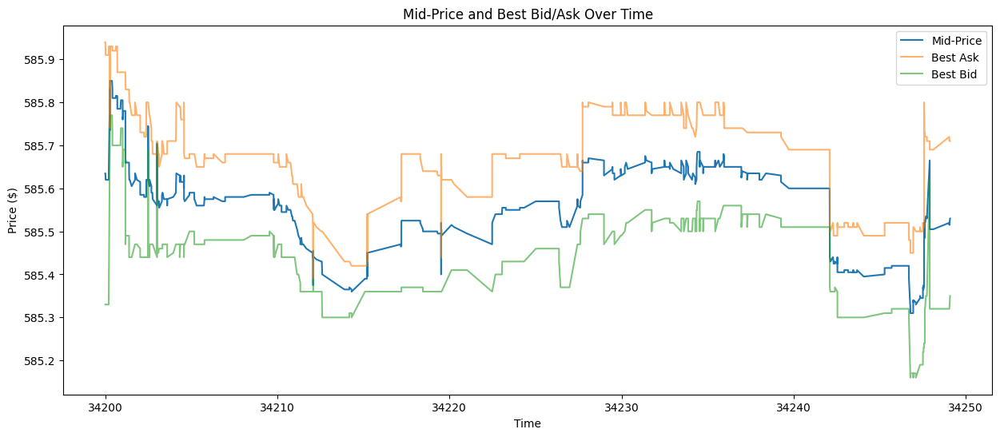

In [9]:
# Plot Mid-Price & Best Ask / Best Bid (Faster to use time as a numerical value rather than pandas datetime)
import matplotlib.pyplot as plt

plt.figure(figsize=(15,6))
plt.plot(orderbook['Time'][:1000], orderbook['MidPrice'][:1000], label='Mid-Price')
plt.plot(orderbook['Time'][:1000], orderbook['AskPrice_1'][:1000], label='Best Ask', alpha=0.6)
plt.plot(orderbook['Time'][:1000], orderbook['BidPrice_1'][:1000], label='Best Bid', alpha=0.6)
plt.xlabel('Time')
plt.ylabel('Price ($)')
plt.title('Mid-Price and Best Bid/Ask Over Time')
plt.legend()
plt.show()

In [10]:
import plotly.graph_objects as go 

fig = go.Figure()

fig.add_trace(go.Scatter(x = orderbook['Time'], y = orderbook['MidPrice'], mode = 'lines', name = 'Mid-Price'))
fig.add_trace(go.Scatter(x = orderbook['Time'], y = orderbook['AskPrice_1'], mode = 'lines', name = 'Best Ask', opacity = 0.6))
fig.add_trace(go.Scatter(x = orderbook['Time'], y = orderbook['BidPrice_1'], mode = 'lines', name = 'Best Bid', opacity = 0.6))

fig.update_layout(
    title = 'Mid-Price and Best Bid / Best Ask Over Time',
    xaxis_title = 'Time (Seconds After Midnight)',
    yaxis_title = 'Price ($)',
    legend = dict(x = 0, y = 1),
    width = 1000,
    height = 500, 
    template = 'plotly_dark'
)

In [11]:
# Count Each Message Type
import plotly.express as px

message_counts = messages['TypeLabel'].value_counts()

fig = px.bar(
    message_counts,
    x = message_counts.index,
    y = message_counts.values,
    labels = {
        'x':'Message Type',
        'y':'Count'
    },
    title = 'Distribution of Message Types',
    template = 'plotly_dark'
)

fig.show()

### Depth Chart

In [12]:
# Snapshot
snapshot = orderbook.iloc[10]

# Extract prices and sizes
ask_prices = [snapshot[f'AskPrice_{i}'] for i in range(1, 11)]
ask_sizes = [snapshot[f'AskSize_{i}'] for i in range(1, 11)]

bid_prices = [snapshot[f'BidPrice_{i}'] for i in range(1, 11)]
bid_sizes = [snapshot[f'BidSize_{i}'] for i in range(1, 11)]

# Compute cumulative sizes
ask_cum_sizes = np.cumsum(ask_sizes)
bid_cum_sizes = np.cumsum(bid_sizes)

fig = go.Figure()
fig.add_trace(go.Scatter(x=ask_prices, y=ask_cum_sizes, mode='lines+markers', name='Ask Side'))
fig.add_trace(go.Scatter(x=bid_prices, y=bid_cum_sizes, mode='lines+markers', name='Bid Side'))

fig.update_layout(
    title = 'Order Book Depth Chart (Snapshot)', 
    xaxis_title='Price ($)',
    yaxis_title='Cumulative Size',
    template = 'plotly_dark'
)

In [17]:
import plotly.graph_objects as go
import numpy as np

frames_idx = range(1000, 2000, 10) # Snapshots 1000 to 2000 animated in steps of 10

frames = []
for idx in frames_idx:
    snapshot = orderbook.iloc[idx]

    ask_prices = [snapshot[f'AskPrice_{i}'] for i in range(1, 11)]
    ask_sizes = [snapshot[f'AskSize_{i}'] for i in range(1, 11)]
    bid_prices = [snapshot[f'BidPrice_{i}'] for i in range(1, 11)]
    bid_sizes = [snapshot[f'BidSize_{i}'] for i in range(1, 11)]

    ask_cum_sizes = np.cumsum(ask_sizes)
    bid_cum_sizes = np.cumsum(bid_sizes)

    frames.append(go.Frame(data=[
        go.Scatter(x=ask_prices, y=ask_cum_sizes, mode='lines+markers', name='Ask Side', fill = 'tozeroy'),
        go.Scatter(x=bid_prices, y=bid_cum_sizes, mode='lines+markers', name='Bid Side', fill = 'tozeroy')
    ], name=str(idx)))

# Create initial figure
fig = go.Figure(
    data=[
        go.Scatter(x=[], y=[], mode='lines+markers', name='Ask Side', fill = 'tozeroy'),
        go.Scatter(x=[], y=[], mode='lines+markers', name='Bid Side', fill = 'tozeroy')
    ],
    layout=go.Layout(
        title='Animated Order Book Depth Chart',
        xaxis_title='Price ($)',
        yaxis_title='Cumulative Size',
        xaxis_autorange = True,
        yaxis_autorange = True,
        template = 'plotly_dark',
        updatemenus=[dict(type='buttons', showactive=False,
                          buttons=[dict(label='Play',
                                        method='animate',
                                        args=[None, {"frame": {"duration": 500, "redraw": True},
                                                     "fromcurrent": True}])])]
    ),
    frames=frames
)

fig.show()